<a href="https://colab.research.google.com/github/yuya0901/-/blob/main/Exercise_DMD_distributeColab_ipynb_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
!apt-get update
!apt-get install -y ttf-mscorefonts-installer

Hit:1 https://cli.github.com/packages stable InRelease
Hit:2 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease
Hit:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Hit:4 http://security.ubuntu.com/ubuntu jammy-security InRelease
Hit:5 https://r2u.stat.illinois.edu/ubuntu jammy InRelease
Hit:6 http://archive.ubuntu.com/ubuntu jammy InRelease
Hit:7 http://archive.ubuntu.com/ubuntu jammy-updates InRelease
Hit:8 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Hit:9 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:10 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:11 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Reading package lists... Done
W: Skipping acquire of configured file 'main/source/Sources' as repository 'https://r2u.stat.illinois.edu/ubuntu jammy InRelease' does not seem to provide it (sources.list entry misspelt?)
Reading packag

In [4]:
import matplotlib as mpl
import shutil
import os

# Matplotlibのキャッシュディレクトリを取得
cache_dir = mpl.get_cachedir()
print("キャッシュディレクトリ:", cache_dir)

# キャッシュを削除
if os.path.exists(cache_dir):
    shutil.rmtree(cache_dir)
    print("キャッシュを削除しました")


キャッシュディレクトリ: /root/.cache/matplotlib
キャッシュを削除しました


In [5]:
import numpy as np
import scipy as sp
import math
import os
import csv
import cv2
from PIL import Image
from time import time

from scipy.linalg import svd
from scipy.linalg import pinv
from scipy.sparse.linalg import svds

import matplotlib.pyplot as plt
%matplotlib inline

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm

# (あなたのコードに依存する変数設定例)
ny, nx = 100, 100
U = np.random.rand(ny * nx, 10)

# フォントの設定をTimes New Romanに強制的に変更
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.serif'] = ['Times New Roman']
plt.rcParams['mathtext.fontset'] = 'custom'
plt.rcParams['mathtext.rm'] = 'Times New Roman'
plt.rcParams['mathtext.it'] = 'Times New Roman:italic'
plt.rcParams['mathtext.bf'] = 'Times New Roman:bold'
plt.rcParams['font.size'] = 18


for index in range(10):
    mode = U[:, index]
    mode = mode.reshape(ny, nx)
    plt.figure(figsize = (8,3), dpi=100, facecolor='w', edgecolor='b')

    plt.imshow(mode, cmap='rainbow')
    plt.title(f'POD Mode {index+1}')
    plt.savefig('mode_img_'+str(index).zfill(3)+'.png')
    plt.close()

<div align='center' style="font-size:18px">
1.計算に使うサブルーチン
</div>

In [7]:
def imgnorm(img):
    dmax=np.max(img)
    dmin=np.min(img)
    dptp=np.ptp(img) #dmax-dmin
    image=(img-dmin)/dptp
    return image

def image_maker(folder,header,data,nx,ny):
    outdir=folder
    data2=imgnorm(data)
    dmy,nt=data2.shape
    if os.path.isdir(outdir):
        print ("Result save path already exists")
    else:
        os.makedirs(outdir)
        print (outdir + "is created")
    for index in range(data2.shape[1]):
        img=data2[:,index].reshape(ny,nx)
        outimg = Image.fromarray(np.uint8(plt.cm.seismic(img)*255))
        outname=outdir+header+'_'+str(index).zfill(3)+'.png'
        outimg.save(outname,'png')

def vector_img(folder,header,u,v,nx,ny,cmax):
    outimg=folder
    dmy,nt=u.shape
    if os.path.isdir(outimg):
        print ("Result save path already exists")
    else:
        os.makedirs(outimg)
        print (outimg + "is created")

    x=np.linspace(0,nx-1,nx)
    y=np.linspace(0,ny-1,ny)
    [X,Y]=np.meshgrid(x,y)
    U=u.reshape(ny,nx,nt)
    V=v.reshape(ny,nx,nt)
    amp=np.sqrt(U**2+V**2)

    for index in range(nt):
        plt.figure(figsize = (20,7.5))
        plt.rcParams['font.size']=18
        # plt.aspect('equal')
        im=plt.quiver(X[::4,::4], Y[::4,::4], U[::4,::4,index], V[::4,::4,index],amp[::4,::4,index],angles='xy',scale_units='xy',cmap='rainbow',pivot='mid',alpha=1,headlength=0.4, headwidth=0.2,scale=0.08)
        im.set_clim(0,cmax)
        clb=plt.colorbar(im)
        clb.set_label('Velocity [m/s]')
        plt.xlabel('X')
        plt.ylabel('Y')
        outname=outimg+header+'_'+str(index).zfill(3)+'.png'
        plt.savefig(outname)
        plt.show()
#         plt.close()
#         plt.clf()

def movie_maker(folder,vname,nx,ny):
    #フォルダにあるファイルのリストを読み込む
    fmovie=os.listdir(folder)
    fmovie.sort()
    fmovie=[filename for filename in fmovie if not filename.startswith('.')]
    wfname='/content/drive/MyDrive/Colab Notebooks/'+vname+'.mp4'
    # wfname=vname+'.mp4'
    fourcc = cv2.VideoWriter_fourcc('m','p','4','v')
    fps=30.0
    video = cv2.VideoWriter(wfname, fourcc, fps, (nx, ny))
    for index in range(len(fmovie)):
        img=cv2.imread(folder+fmovie[index].format(index))
        video.write(img)
    video.release()

In [8]:
# filename='/Users/shinjinakaya/Desktop/Vortex/VORTALL.csv'
# filename2='/Users/shinjinakaya/Desktop/Vortex/UALL.csv'
# filename3='/Users/shinjinakaya/Desktop/Vortex/VALL.csv'
# with open(filename3) as file:
#     inputdata=csv.reader(file)
# #     data=[line for line in inputdata]
#     data=[]
#     for line in inputdata:
#         dat=[item for item in line if item !='']
#         data.append(dat)
# data=np.array(data,dtype=np.float64)
# print(data.shape)
# nx,ny=449,199
# nd,nt=data.shape
# for index in range(nt):
#     data1=data[:,index]
#     if index==0:
#         data2=data1.reshape(nx,ny).T
#         data2=data2.reshape(-1,1)
#         A=data2
#     else:
#         data2=data1.reshape(nx,ny).T
#         data2=data2.reshape(-1,1)
#         A=np.c_[A,data2]
#三つ読み込んで
# np.savez_compressed('data',u=A2,v=A3,vort=A1)

<div align="center" style="font-size:18px">
2.データを読み込んでみよう
</div>
<p>
PODやDMDを実施するために円柱後流の速度($u$,$v$)と渦度をデータとして保存している．pythonのバイナリファイルで圧縮して'data.npz'保存してある．データは以下の通りである．列毎にreshape(ny,nx)で元の形になる．Uのデータ行列，Vのデータ行列，vorticityのデータ行列からなる．
</p>
<ol>
<li>データの次元は89351$\times$151
<li>$nx=449,ny=199,nn=151$
<li>$dt=0.2$s
<li>$Re=100$   
</ol>


In [9]:

#colaboratoryでする場合
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [10]:
#データのあるフォルダ
# inpdir='/Users/shinjinakaya/Desktop/Vortex/'
inpdir=os.getcwd()+'/'
inpdir='/content/drive/MyDrive/Colab Notebooks/'
#データファイル名
# datafile='data.npz'
datafile=inpdir+'data.npz'
#データのロード
Data=np.load(datafile)
#データを確認し各々を読み込んで配列に格納
print(Data.files)
u=Data['u']
v=Data['v']
vort=Data['vort']
#速度をまとめてモードを出すため，結合しておく
vel=np.r_[u,v]
#画像nx*ny,枚数nt
nx,ny,nt=449,199,151

['u', 'v', 'vort']


<div align="center" style="font-size:18px">
3.データを可視化しよう
</div>

<div align="left" style="font-size:15px">
3.1 カルマン渦のデータを見る
</div>
<p>
・与えられたデータを可視化して確認しよう
</p>

Result save path already exists


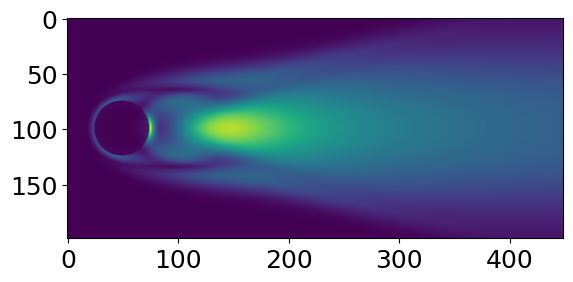

In [11]:
#最大値と最小値の確認
maxv,minv=np.max(vort),np.min(vort)
#平均画像，標準偏差画像
average=np.mean(vort,axis=1).reshape(ny,nx)
stddev=np.std(vort,axis=1).reshape(ny,nx)
plt.imshow(average)
plt.imshow(stddev)
#画像作成
outimgdir='volimg/'
image_maker(inpdir+outimgdir,'imvol',vort,nx,ny)
#動画作成
movie_maker(inpdir+outimgdir,'vorticity',nx,ny)

In [12]:
print(vort.shape)

(89351, 151)


Result save path already exists


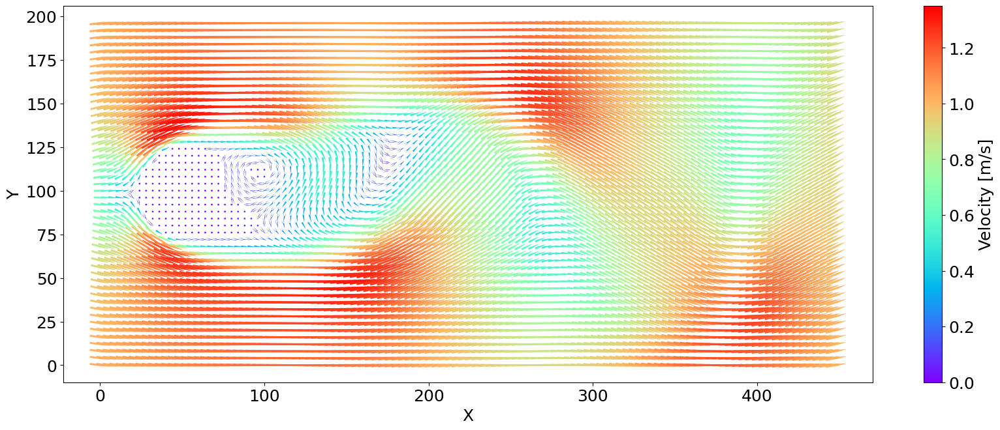

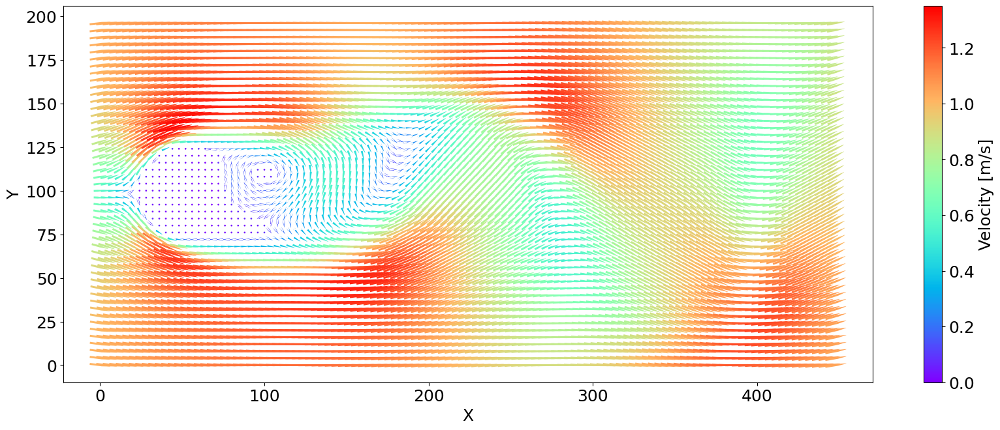

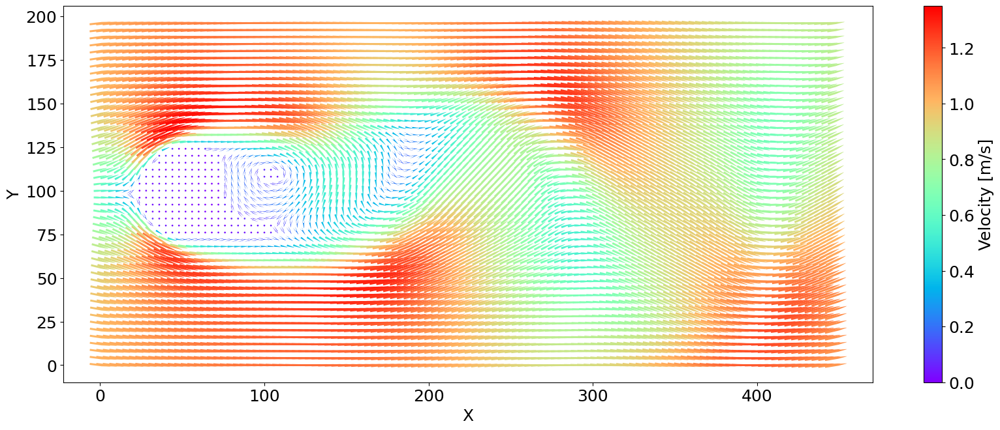

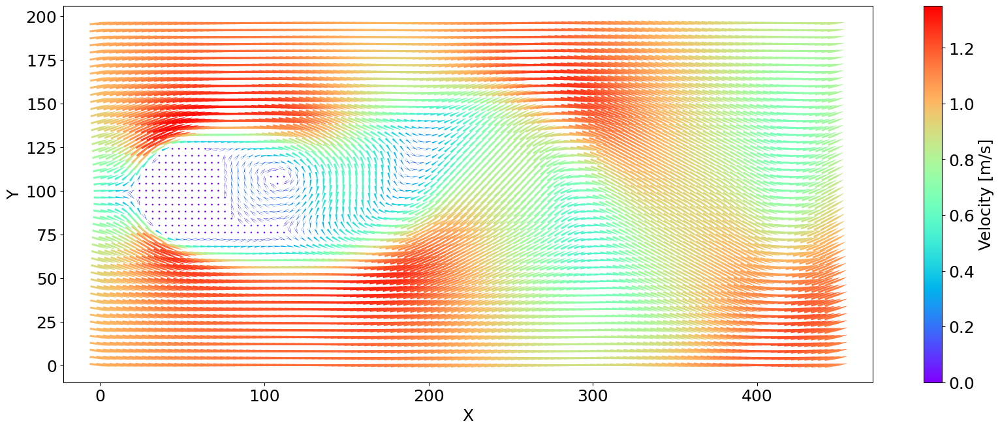

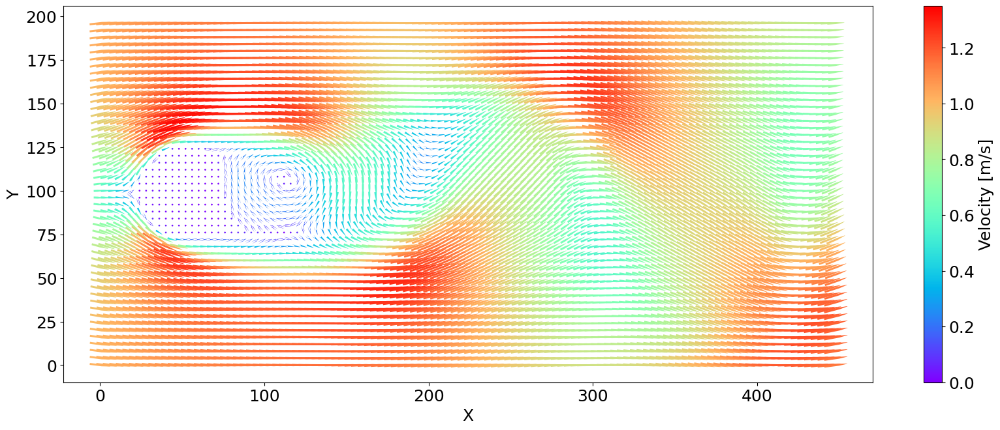

...

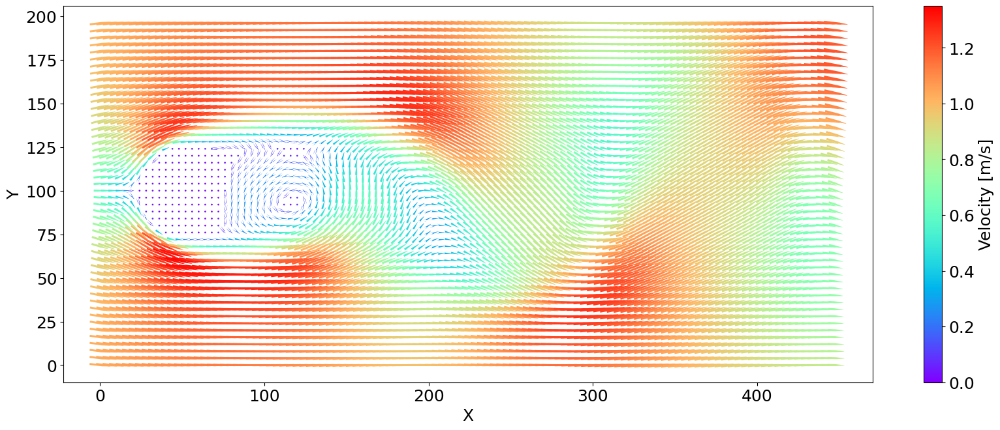

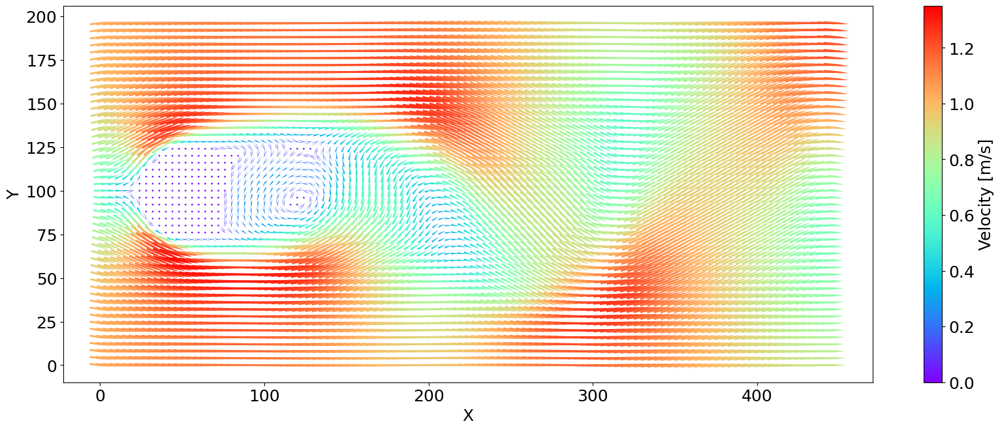

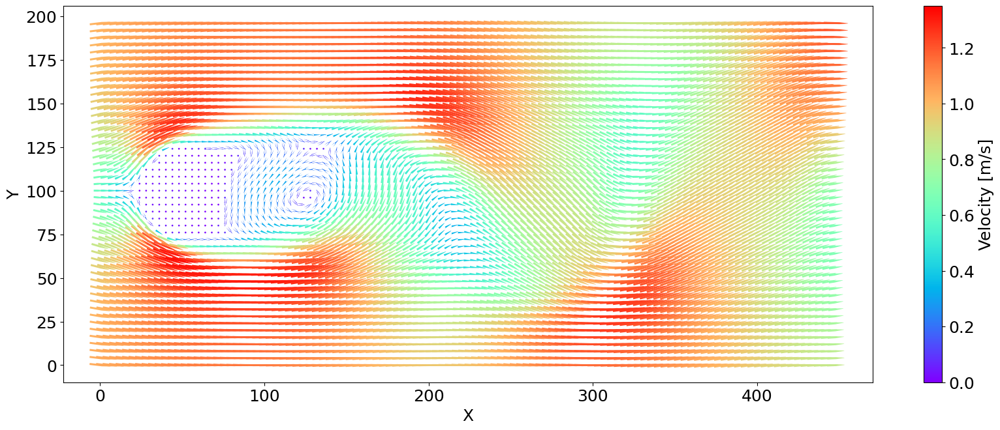

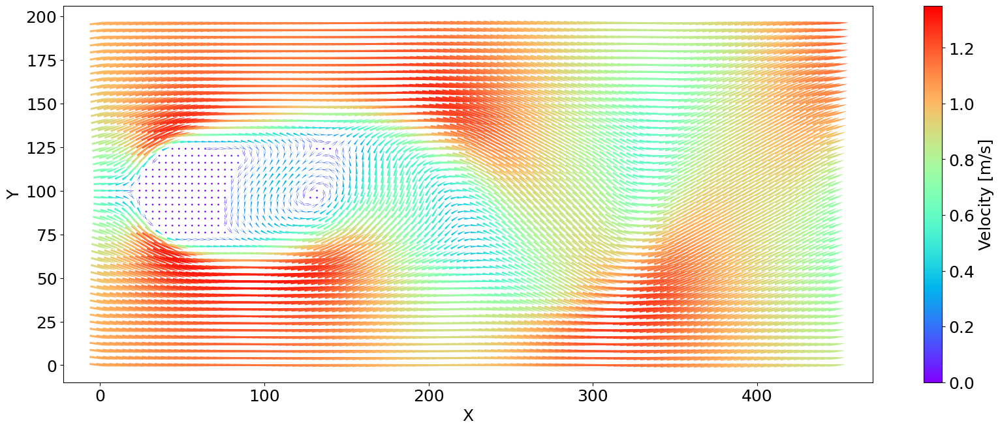

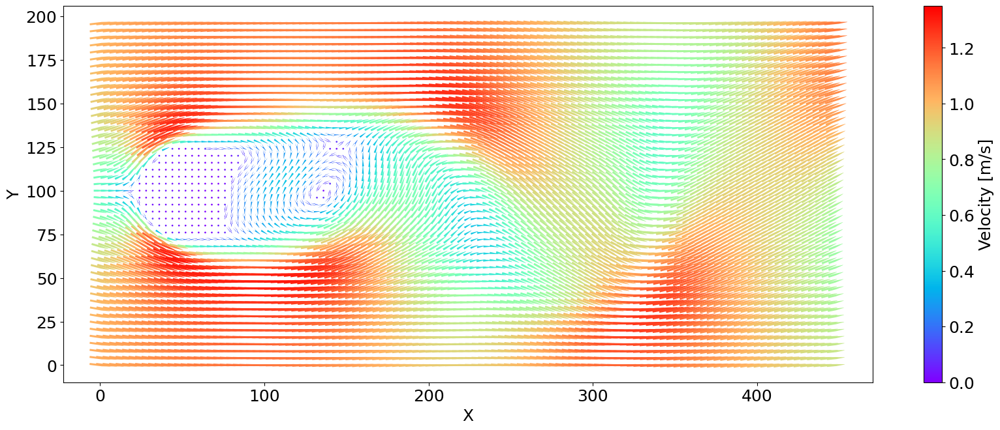

In [ ]:
#ベクトル図作成
vecimgdir='vecimg/'
vector_img(inpdir+vecimgdir,'vector',u,v,nx,ny,1.35)
img=cv2.imread(inpdir+vecimgdir+'vector_000.png')
h,w,ch=img.shape
movie_maker(inpdir+vecimgdir,'vector',w,h)

In [ ]:
x=np.linspace(0,nx-1,nx)
y=np.linspace(0,ny-1,ny)
[X,Y]=np.meshgrid(x,y)
UU=u[:,150].reshape(ny,nx)
VV=v[:,150].reshape(ny,nx)
amp=np.sqrt(UU**2+VV**2)
vmax=np.max(amp)
plt.figure(figsize = (16,6),dpi=200)
plt.rcParams['font.size']=18
# plt.aspect('equal')
im=plt.quiver(X[::4,::4], Y[::4,::4], UU[::4,::4], VV[::4,::4],amp[::4,::4],angles='xy',scale_units='xy',cmap='rainbow',pivot='mid',alpha=1,headlength=0.4, headwidth=0.2,scale=0.08)
im.set_clim(0,1.35)
clb=plt.colorbar(im)
clb.set_label('Velocity [m/s]')
plt.xlabel('X')
plt.ylabel('Y')
plt.savefig('velocity_example.png')
plt.show()
plt.close()
plt.clf()
print(vmax)

<div align="left" style="font-size:15px">
3.1 画像の統計データを可視化
</div>
<p>
・numpyの関数を使って平均，標準偏差，瞬間値と画像を作成する．
</p>

In [ ]:
#速度の大きさの平均，標準偏差，瞬間値を表示する．
vamp=np.sqrt(u**2+v**2)
average=np.mean(vamp,axis=1).reshape(ny,nx)
stddev=np.std(vamp,axis=1).reshape(ny,nx)
spontaneous=vamp[:,0].reshape(ny,nx)

#フォルダの作成
outdir='statistics/'
if os.path.isdir(outdir):
    print ("Result save path already exists")
else:
    os.makedirs(outdir)
    print (outdir + "is created")

#平均画像
avimg=imgnorm(average)
plt.imshow(avimg,cmap='rainbow')
outimg = Image.fromarray(np.uint8(plt.cm.rainbow(avimg)*255))
outname=outdir+'mean.png'
outimg.save(outname,'png')

#標準偏差
stdimg=imgnorm(stddev)
outimg = Image.fromarray(np.uint8(plt.cm.rainbow(stdimg)*255))
outname=outdir+'stddev.png'
outimg.save(outname,'png')
plt.imshow(stddev,cmap='rainbow')

#瞬間画像
spimg=imgnorm(spontaneous)
outimg = Image.fromarray(np.uint8(plt.cm.rainbow(spimg)*255))
outname=outdir+'spontaneous.png'
outimg.save(outname,'png')
plt.imshow(spimg,cmap='rainbow')

<div align="left" style="font-size:15px">
3.2 元データを実験的に解析してみよう．
</div>
<p>
・円柱後流の中心軸上，流れ方向でちょうど中点の位置のデータと中心からずらした場合のデータを解析してみよう．
</p>

In [ ]:
#obsrvation parameter
fps=5
dt=1/fps
N=nt
time=np.linspace(0,1/fps*(N-1),N)

iy=50
ip=nx*ny//2+nx//2+iy*nx

In [ ]:
#速度各成分と絶対値
fig=plt.figure(num=None, figsize=(10, 7.5), dpi=75, facecolor='w', edgecolor='b')
# plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size'] = 18
plt.plot(time,u[ip,:], color='#FF0000',alpha=0.5,linestyle='solid',linewidth=2,label='u') #ここだけで画像をかける
plt.plot(time,v[ip,:], color='#00FF00',alpha=0.5,linestyle='solid',linewidth=2,label='v') #ここだけで画像をかける
plt.plot(time,vamp[ip,:], color='#0000FF',alpha=0.5,linestyle='solid',linewidth=2,label='amp') #ここだけで画像をかける
plt.xlabel('Time [s]')
plt.ylabel('Velocity [m/s]')
# plt.xlim(1.44,1.53)
# plt.ylim(100,400)
plt.legend(loc="center right")
plt.savefig(outdir+'velocity_history.png')
plt.show()
#渦度
fig=plt.figure(num=None, figsize=(10, 7.5), dpi=75, facecolor='w', edgecolor='b')
# plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size'] = 18
plt.plot(time,vort[ip,:], color='#000000',alpha=0.5,linestyle='solid',linewidth=2,label='vorticity') #ここだけで画像をかける
plt.xlabel('Time [s]')
plt.ylabel('Vorticity [1/s]')
# plt.xlim(1.44,1.53)
# plt.ylim(100,400)
plt.legend(loc="upper right")
plt.savefig(outdir+'vorticity_history.png')
plt.show()

In [ ]:
#FFT
freq=np.linspace(0,fps,N)
FFT=np.fft.fft(vort[ip,:])
amp=np.abs(FFT)

#結果表示
fig=plt.figure(num=None, figsize=(10, 5), dpi=200, facecolor='w', edgecolor='b')
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size'] = 18
plt.yscale('log')
plt.scatter(freq,amp,color='#0000FF',alpha=0.5,s=10,label='vorticity') #ここだけでいける
plt.bar(freq,amp,color='#0000FF',width=0.005)
plt.xlabel('Frequency [Hz]')
plt.ylabel('Ampritude [count]')
plt.xlim(0,fps/2)
plt.ylim(1e-3,250)
plt.legend(loc='upper right')
plt.savefig(outdir+'FFT_vorticity.png')
plt.show()

<div align="center" style="font-size:18px">
4.固有直交分解(POD)
</div>
<p>
・PCA(Principal Component Analysis)を実施し，PODを実施する．画像の次元およびデータ数を考慮して計算することを考える．
</p>

In [ ]:
# ここでの考え方X∈R^DxN
#ここではPODの特異値を出す．
# Covariance Matrix(共分散行列)となり普通のPCA
def Rmode(X):
    mm,nn=X.shape
    A=X@X.T
    la,U=np.linalg.eig(A)
    sort_index=np.argsort(la)[::-1]
    la=la[sort_index]
    U=U[:,sort_index]
    #PODの特異値とPODモードを返す．
    return np.real(np.sqrt(la)),np.real(U)

# Gram Matrix(グラム行列)となり双対PCA
def Qmode(X):
    mm,nn=X.shape
    A=X.T@X
    la,V=np.linalg.eig(A)
    sort_index=np.argsort(la)[::-1]
    la=la[sort_index]
    V=V[:,sort_index]
    return np.sqrt(la),X@V@np.diag(1/np.sqrt(la))

In [ ]:
#フォルダの作成
outdir='POD_results/'
if os.path.isdir(outdir):
    print ("Result save path already exists")
else:
    os.makedirs(outdir)
    print (outdir + "is created")

In [ ]:
#POD
data=vort
sig,U=Qmode(data)
#ここでoutputしているのはV*
V=np.diag(1/sig)@U.T@data
# SVDはnumpyを使ってもできる．実行してみて計算時間を比較してみよう．双対問題を解くと最適
# U1,S1,V1= np.linalg.svd(data)

In [ ]:
#固有値の表示
inum=np.linspace(0,N-1,N)
fig=plt.figure(num=None, figsize=(10, 5), dpi=200, facecolor='w', edgecolor='b')
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size'] = 18
plt.yscale('log')
plt.scatter(inum,sig,color='#FF0000',alpha=0.5,s=20) #ここだけでいける
plt.plot(inum,sig,color='#FF0000',linewidth=1)
# plt.bar(inum,sig,color='#FF0000',width=0.05)
plt.xlabel('Mode num')
plt.ylabel('Eigenvalue')
plt.xlim(0,30)
# plt.ylim(1e-3,250)
# plt.legend(loc='upper right')
plt.savefig(outdir+'FFT_Mode'+str(ip).zfill(3)+'.png')
plt.show()

In [ ]:

# nd,N=U.shape
# UU1=U[:nd//2,:]
# VV1=U[nd//2:,:]
# VEL=np.sqrt(UU1**2+VV1**2)
for index in range(10):
#     mode=VEL[:,index]

    mode=U[:,index]
    mode=mode.reshape(ny,nx)
    plt.figure(figsize = (8,3), dpi=100, facecolor='w', edgecolor='b')
    plt.rcParams['font.size']=18
    plt.imshow(mode,cmap='rainbow')
    plt.title(f'POD Mode {index+1}')
    plt.savefig('mode_img_'+str(index).zfill(3)+'.png')
# plt.close()
# plt.clf()

In [ ]:
modenum=5
fig=plt.figure(num=None, figsize=(10, 5), dpi=200, facecolor='w', edgecolor='b')
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size'] = 18
for index in range(modenum):
    plt.plot(time,V[index,:],alpha=0.8,linestyle='solid',linewidth=1,label='Mode'+str(index))
plt.xlabel('Time [s]')
plt.ylabel('Ampritude [count]')
# plt.xlim(1.44,1.53)
# plt.ylim(100,400)
plt.legend(loc='lower left')
plt.savefig(outdir+'Profile_mode'+str(modenum)+'.png')
plt.show()

In [ ]:
mode_num=0
#FFT
freq=np.linspace(0,fps,N)
FFT=np.fft.fft(V[mode_num,:])
amp=np.abs(FFT)

#結果表示
fig=plt.figure(num=None, figsize=(10, 5), dpi=200, facecolor='w', edgecolor='b')
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size'] = 18
plt.yscale('log')
plt.scatter(freq,amp,color='#FF0000',alpha=0.5,s=10,label='vorticity') #ここだけでいける
plt.bar(freq,amp,color='#FF0000',width=0.002)
plt.xlabel('Frequency [Hz]')
plt.ylabel('Ampritude [count]')
plt.xlim(0,fps/2)
# plt.ylim(1e-3,250)
plt.legend(loc='upper right')
plt.savefig(outdir+'FFT_Mode'+str(mode_num).zfill(3)+'.png')
plt.show()

mode_num=1
#FFT
freq=np.linspace(0,fps,N)
FFT=np.fft.fft(V[mode_num,:])
amp=np.abs(FFT)

#結果表示
fig=plt.figure(num=None, figsize=(10, 5), dpi=200, facecolor='w', edgecolor='b')
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size'] = 18
plt.yscale('log')
plt.scatter(freq,amp,color='#FF0000',alpha=0.5,s=10,label='vorticity') #ここだけでいける
plt.bar(freq,amp,color='#FF0000',width=0.002)
plt.xlabel('Frequency [Hz]')
plt.ylabel('Ampritude [count]')
plt.xlim(0,fps/2)
# plt.ylim(1e-3,250)
plt.legend(loc='upper right')
plt.savefig(outdir+'FFT_Mode'+str(mode_num).zfill(3)+'.png')
plt.show()

<div align="center" style="font-size:18px">
4.動的モード分解(DMD)
</div>
<p>
・PODモードを利用して計算を簡略化する．ここで実施するのはexact DMD.
</p>

In [ ]:
#Dynamic Mode Decomposition
Y=data[:,1:]
X=data[:,:-1]
print(Y.shape,X.shape)

In [ ]:
#フォルダの作成
outdir='DMD_results/'
if os.path.isdir(outdir):
    print ("Result save path already exists")
else:
    os.makedirs(outdir)
    print (outdir + "is created")

In [ ]:
#Proper Orthogonal Decomposition
sig2,U2=Qmode(X)
V2=np.diag(1/sig2)@U2.T@X

In [ ]:
#Projection of A on the POD mode coordinate
Atilde=np.conjugate(U2.T)@Y@np.conjugate(V2.T)@np.diag(1/sig2) #U^*AU

In [ ]:
#Eigen Value decomposition
Lambda,W=np.linalg.eig(Atilde)
Phi=Y@np.conjugate(V2.T)@np.diag(1/sig2)@W

In [ ]:
#Calculation of Psuedo Inverse
b = (np.linalg.inv(Phi.T @ Phi)) @ (Phi.T @ X[:,0])
#Vander Matrix
Vand = np.vander(Lambda, len(b), True)
Psi=np.diag(b) @ Vand

In [ ]:
fig=plt.figure(num=None, figsize=(8, 6), dpi=200, facecolor='w', edgecolor='b')
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size'] = 12
        # plt.axis([np.min(Xi), np.max(Xi), np.min(Yi), np.max(Yi)])
        # plt.axis('tight')
im2=plt.scatter(np.real(Lambda),np.imag(Lambda),linewidths=0,s=30,c=np.abs(Lambda),marker='s',cmap='rainbow',alpha=1.0)
plt.xlabel('Real')
plt.ylabel('Im')
clb2=plt.colorbar(im2)
clb2.set_label(r'Abs[$\lambda$]')
plt.savefig(outdir+'DMD_eigenvalue.png', dpi=200)
plt.show()

In [ ]:
#DMD Mode
for index in range(150):
#     mode=VEL[:,index]
    mode=np.real(Phi[:,index])
    mode=mode.reshape(ny,nx)
    plt.figure(figsize = (8,3), dpi=100, facecolor='w', edgecolor='b')
    plt.rcParams['font.size']=12
    plt.imshow(mode,cmap='rainbow')
    plt.savefig(outdir+'DMD_mode_img_'+str(index).zfill(3)+'.png')
# plt.close()

In [ ]:
# omega=np.angle(Lambda)/dt
# fs1=omega/2/np.pi
# sigma1=np.log(np.abs(Lambda))/(dt)
fs=np.imag(np.log(Lambda)/(2.0*np.pi*dt))
sigma=np.real(np.log(Lambda)/(dt))

In [ ]:
fig=plt.figure(num=None, figsize=(12, 4), dpi=200, facecolor='w', edgecolor='b')
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size'] = 12
# plt.yscale('log')
plt.scatter(fs,sigma, color='#FF0000',alpha=0.5,s=10)
plt.bar(fs,sigma,color='#FF0000',width=0.005)
plt.hlines(y=[0], xmin=0, xmax=10, colors='b', linestyles='solid', linewidths=1)
plt.xlabel('Frequency [Hz]')
plt.ylabel('Growth rate [1/s]')
plt.xlim(0,2.5)
plt.ylim(-0.25,0.025)
# plt.legend(loc='upper right')
plt.savefig(outdir+'DMD_growth_rate.png')
plt.show()

In [ ]:
fig=plt.figure(num=None, figsize=(12, 4), dpi=200, facecolor='w', edgecolor='b')
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size'] = 12
# plt.yscale('log')
plt.scatter(fs,np.abs(b), color='#FF0000',alpha=0.5,s=10)
plt.bar(fs,np.abs(b),color='#FF0000',width=0.0025)
plt.xlabel('Frequency [Hz]')
plt.ylabel('Ampritude [count]')
plt.xlim(0,)
plt.ylim(0,100)
# plt.legend(loc='upper right')
plt.savefig(outdir+'DMD_amplitude.png')
plt.show()

In [ ]:
fig=plt.figure(num=None, figsize=(12, 4), dpi=200, facecolor='w', edgecolor='b')
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size'] = 12
# plt.yscale('log')
plt.scatter(fs,np.abs(Psi[:,N//2]), color='#FF0000',alpha=0.5,s=10)
plt.bar(fs,np.abs(Psi[:,N//2]),color='#FF0000',width=0.0025)
plt.xlabel('Frequency [Hz]')
plt.ylabel('Ampritude [count]')
plt.xlim(0,2.5)
# plt.ylim(-0.25,0.025)
# plt.legend(loc='upper right')
plt.savefig(outdir+'DMD_Coefficient.png')
plt.show()

In [ ]:
sigma_id=np.argsort(sigma)[::-1]
sigma2=sigma[sigma_id]
Phi2=Phi[:,sigma_id]
Psi2=Psi[sigma_id,:]
b2=b[sigma_id]
Vand2=Vand[sigma_id]
fs2=fs[sigma_id]

In [ ]:
idd=np.where(sigma2>0)[0]
print(idd)

In [ ]:
for index in idd:
    if fs2[index]>0:
        dmdmode=imgnorm(np.real(Phi2[:,index]).reshape(ny,nx))
        plt.imshow(dmdmode,cmap='seismic')
        outimg = Image.fromarray(np.uint8(plt.cm.seismic(dmdmode)*255))
        outname=outdir+'dmd_unstable'+str(fs2[index])+'.png'
        outimg.save(outname,'png')


In [ ]:
print(Phi2.shape,Psi2.shape)
Data=Phi2[:,0:8]@Psi2[0:8,:]
unst_dmda=np.mean(Data,axis=0)
time2=time[:-1]

fig=plt.figure(num=None, figsize=(5, 3.75), dpi=100, facecolor='w', edgecolor='b')
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size'] = 12
plt.plot(time2,unst_dmda, color='#FF0000',alpha=0.5,linestyle='solid',linewidth=1,label='Unstable mode')
plt.xlabel('Frequency [Hz]')
plt.ylabel('Coeffcient [count]')
plt.xlim(0,)
plt.legend(loc='upper right')
plt.savefig(outdir+'Unstable_mean_DMD.png')
plt.show()

In [ ]:
print(sigma2)
print(Vand2[:,0])

In [ ]:
print(os.path.exists('/content/drive'))
print(os.listdir('/content/drive/MyDrive/Colab Notebooks'))

In [ ]:
print(inpdir.split('/'))